In [5]:
import sys
import os
import importlib
# make the module available from the src directory
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

In [12]:
from src.dataLoaders.DataLoader import DataSetLoader
importlib.reload(sys.modules['src.dataLoaders.DataLoader'])
data_dir = '../datasets/artificial_data/'

dataset = 'SimpleNoisyImageGenerator'
data_loader = DataSetLoader(data_dir=f'{data_dir}{dataset}')
data_loader.load_data()

In [16]:
from src.models.baseModels.resnet_regression import ResNetModel
importlib.reload(sys.modules['src.models.baseModels.resnet_regression'])

data_dir = '../datasets/artificial_data/'
dataset_name = 'SimpleNoisyImageGenerator'

resnet = ResNetModel(
    data_dir=f'{data_dir}{dataset_name}', 
    num_epochs=80,
    learning_rate=0.01,
    weight_decay=1e-4,
    early_stopping_tol=30,
    early_stopping_min_delta=10,
    depth=34,
    dataLoader=data_loader,
)


#resnet.load_data()
resnet.train()
resnet.evaluate()

Is cuda available:  True
Epoch 1/80, Train Loss: 1.0290882963176059e+33, Val Loss: 3.0537550562309226e+33
Epoch 2/80, Train Loss: 1.0041987721990922e+26, Val Loss: 2.9779323399604854e+26
Epoch 3/80, Train Loss: 4.644259583161099e+17, Val Loss: 1.359141545709321e+18
Epoch 4/80, Train Loss: 235810.70397916753, Val Loss: 684803.58752051
Epoch 5/80, Train Loss: 487.99007436062425, Val Loss: 1430.5063385665417
Epoch 6/80, Train Loss: 38.527149159857565, Val Loss: 110.21824216842651
Epoch 7/80, Train Loss: 19.97627766588901, Val Loss: 53.44692242145538
Epoch 8/80, Train Loss: 73.75471718767857, Val Loss: 210.90043756365776
Epoch 9/80, Train Loss: 20.324880549248228, Val Loss: 56.183819860219955
Epoch 10/80, Train Loss: 13.770857699373936, Val Loss: 36.487720996141434
Epoch 11/80, Train Loss: 15.091113780407195, Val Loss: 40.122867196798325
Epoch 12/80, Train Loss: 14.51499290669218, Val Loss: 38.31382954120636
Epoch 13/80, Train Loss: 15.524039075729695, Val Loss: 40.567247182130814
Epoch 14

In [11]:
from src.dataLoaders.DataLoader import DataSetLoader
importlib.reload(sys.modules['src.dataLoaders.DataLoader'])

dataset = 'SimpleNoisyImageGenerator'
data_loader = DataSetLoader(data_dir=f'{data_dir}{dataset}')
data_loader.load_data()

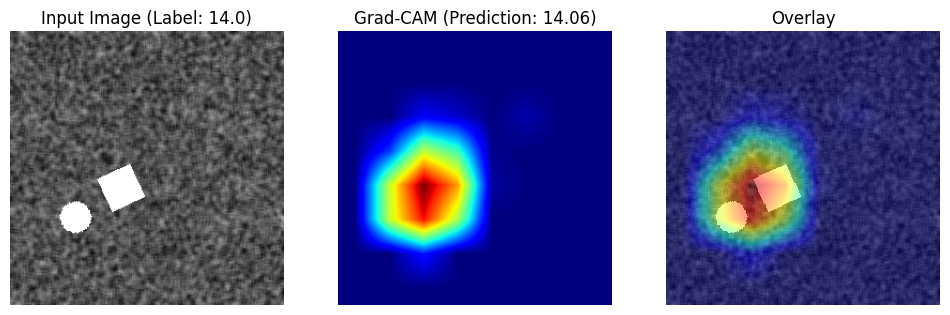

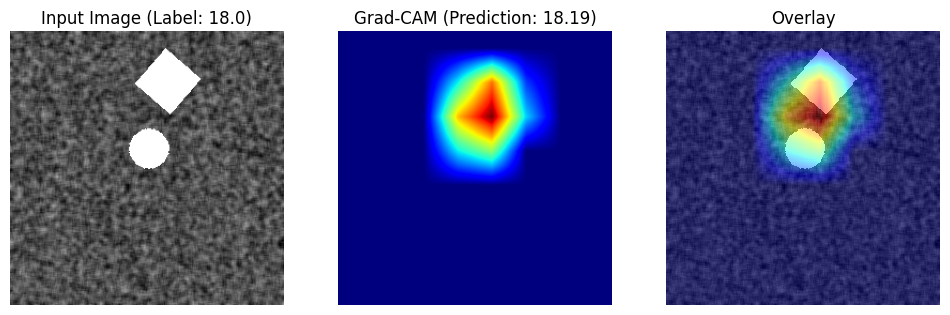

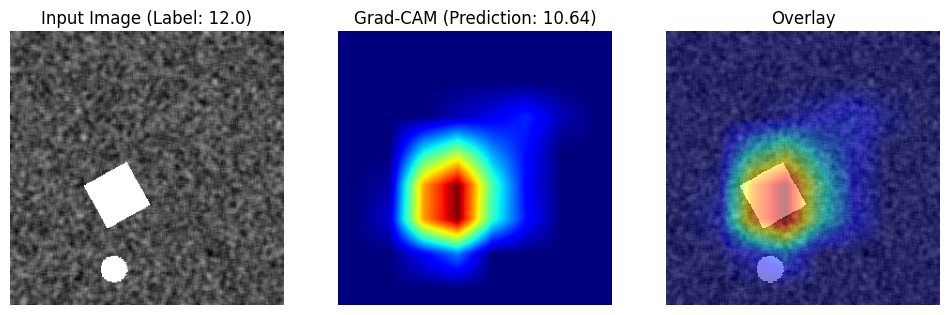

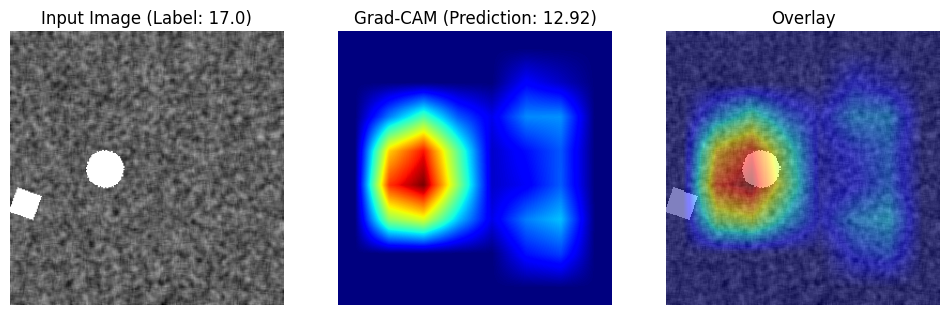

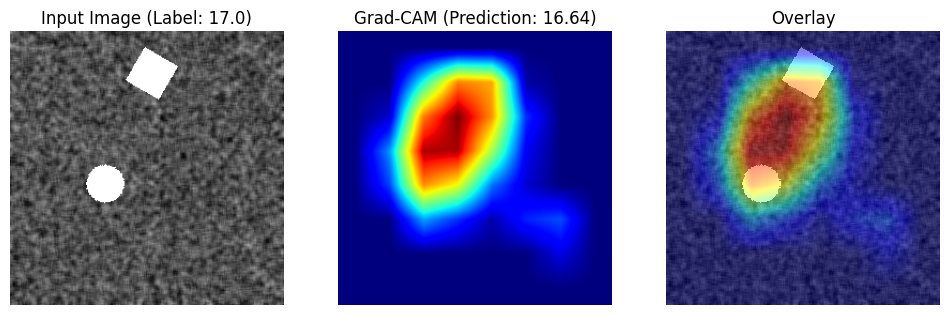

...

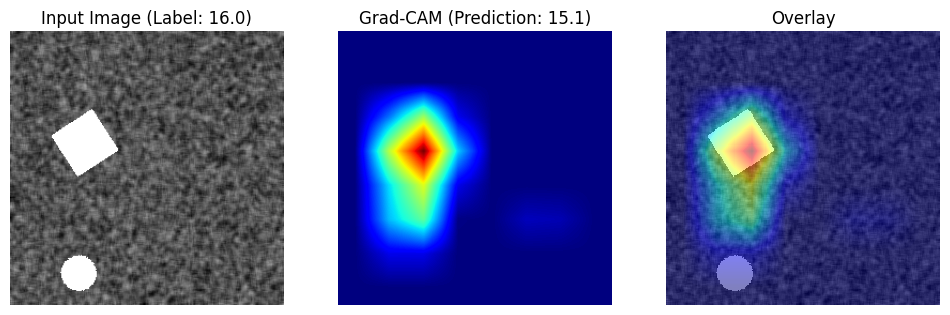

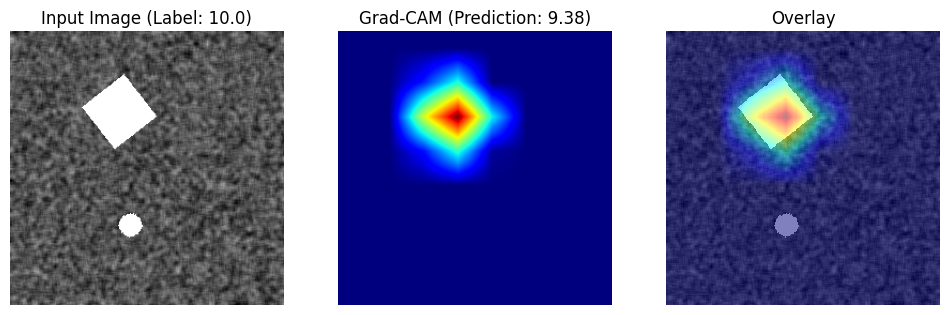

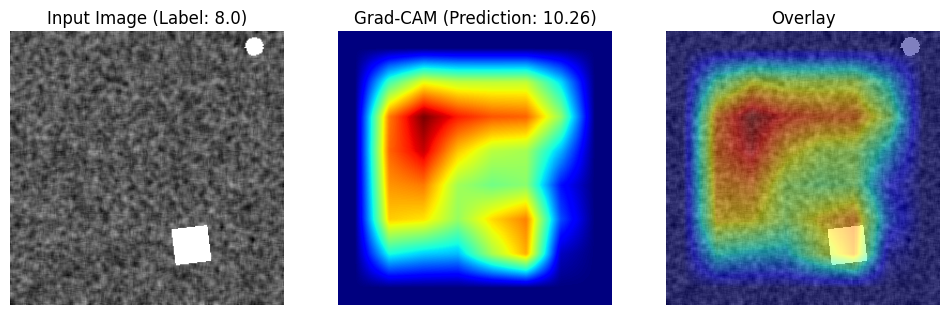

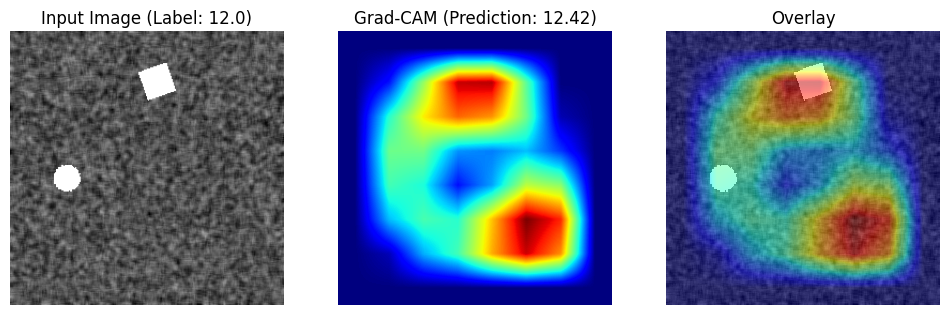

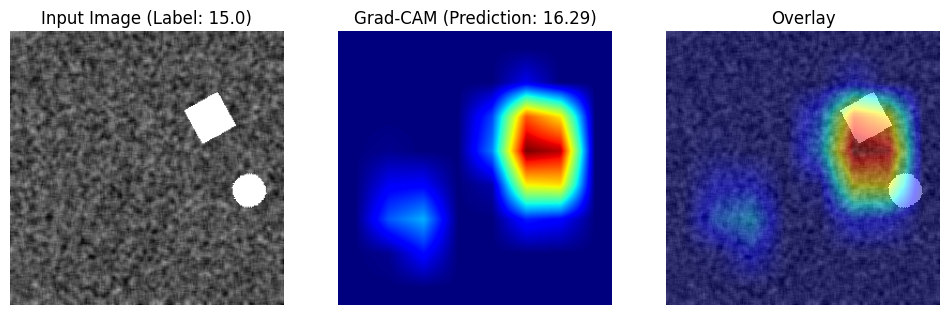

In [54]:
from src.XAI.ModifiedGradCam import ModifiedGradCam
importlib.reload(sys.modules['src.XAI.ModifiedGradCam'])
importlib.reload(sys.modules['src.XAI.utils.SaveFiles'])

grad_cam_mod = ModifiedGradCam(resnet)
for i in range(50):
    grad_cam_mod.generate_grad_cam(index=i)

Max value in heatmap after ReLU is zero3.


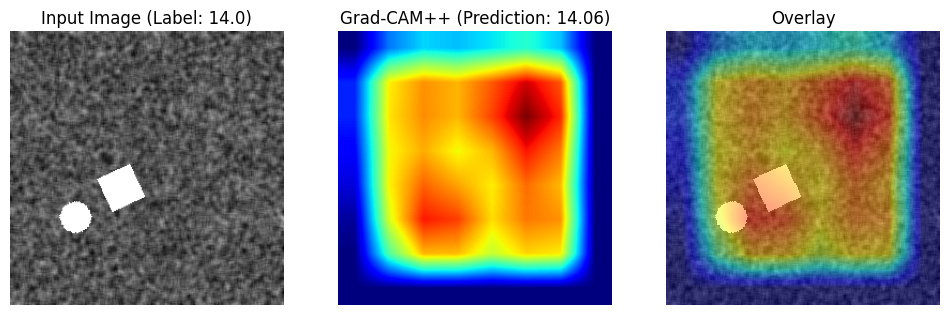

Max value in heatmap after ReLU is zero3.


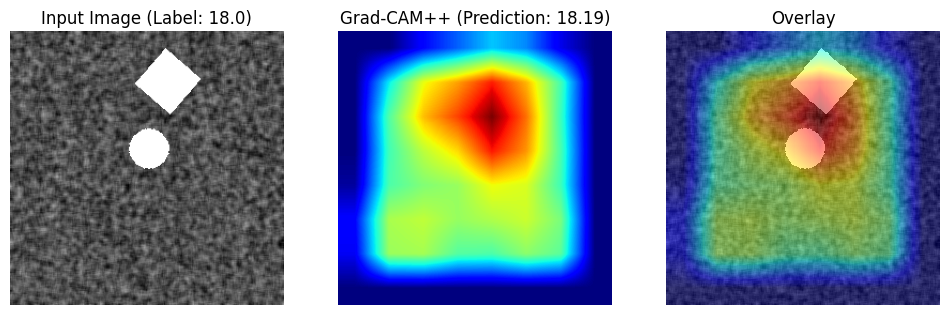

Max value in heatmap after ReLU is zero3.


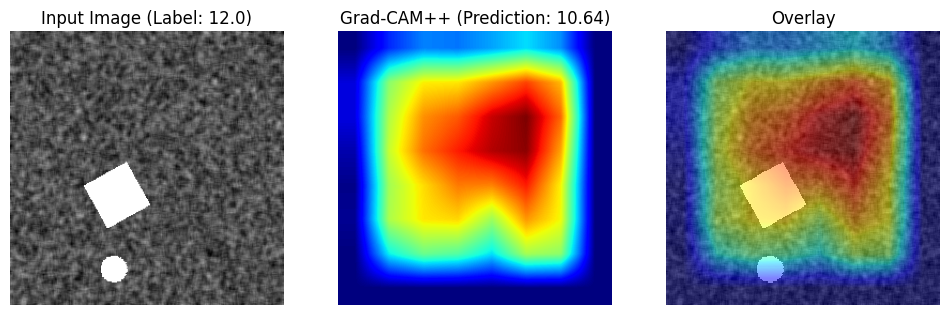

Max value in heatmap after ReLU is zero3.


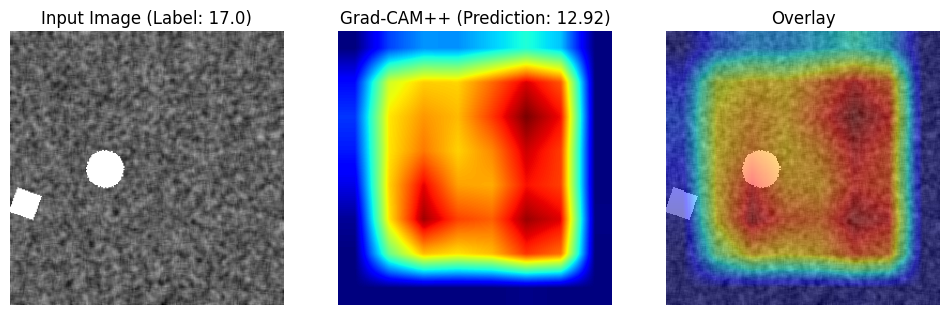

Max value in heatmap after ReLU is zero3.


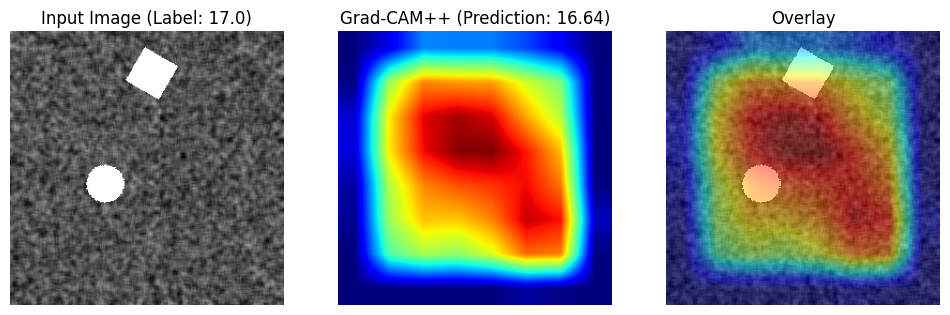

In [30]:
from src.XAI.GradCamPlusPlus import GradCamPlusPlus
importlib.reload(sys.modules['src.XAI.GradCamPlusPlus'])
importlib.reload(sys.modules['src.XAI.utils.SaveFiles'])

grad_cam = GradCamPlusPlus(resnet)
grad_cam.generateMultipleGradCam(5, save_output=False, save_dir='gradcam_output_multiple_10-30_resnet34_plus')

Max value in heatmap before ReLU is: tensor(0.0003, device='cuda:0', grad_fn=<MaxBackward1>)


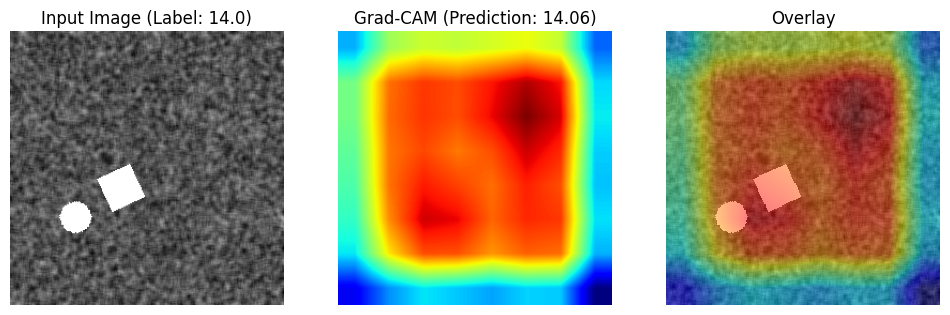

In [27]:
from src.XAI.GradCam import GradCamResnet
importlib.reload(sys.modules['src.XAI.GradCam'])
importlib.reload(sys.modules['src.XAI.utils.SaveFiles'])

grad_cam = GradCamResnet(resnet)
grad_cam.generateMultipleGradCam(1, save_output=True, save_dir='gradcam_output')

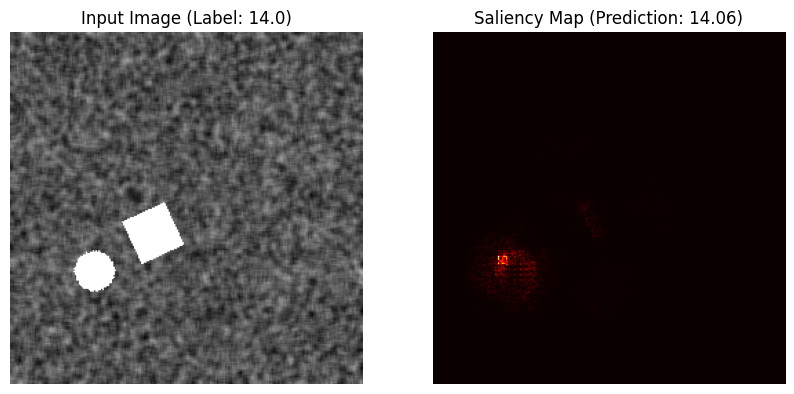

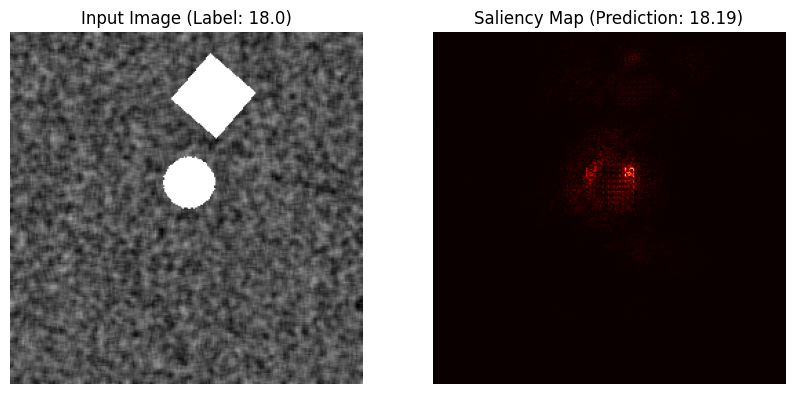

In [51]:
from src.XAI.VanillaSaliency import VanillaSaliency
importlib.reload(sys.modules['src.XAI.VanillaSaliency'])

# Assuming XAIResNet was already imported previously

# Initialize XAI instance
xai_resnet = VanillaSaliency(modelWrapper=resnet, device=resnet.device)
xai_resnet.get_saliency_maps(image_count=2)

c:\Users\askel\anaconda3\envs\MLA\Lib\site-packages\torch\nn\modules\module.py:1352: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


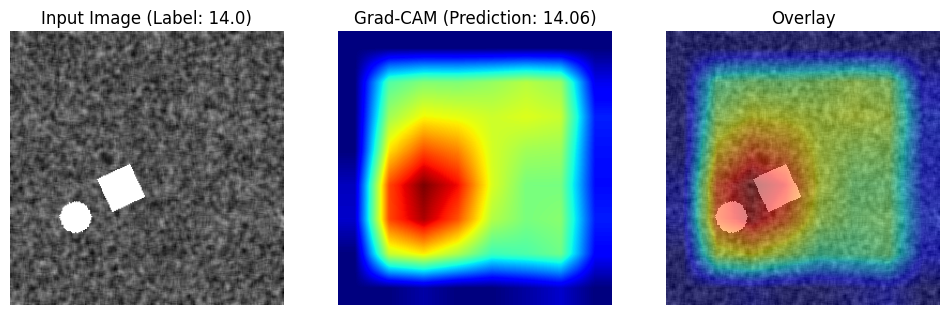

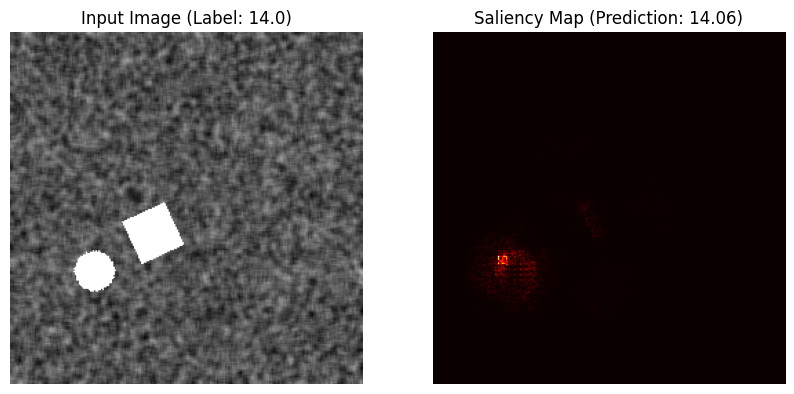

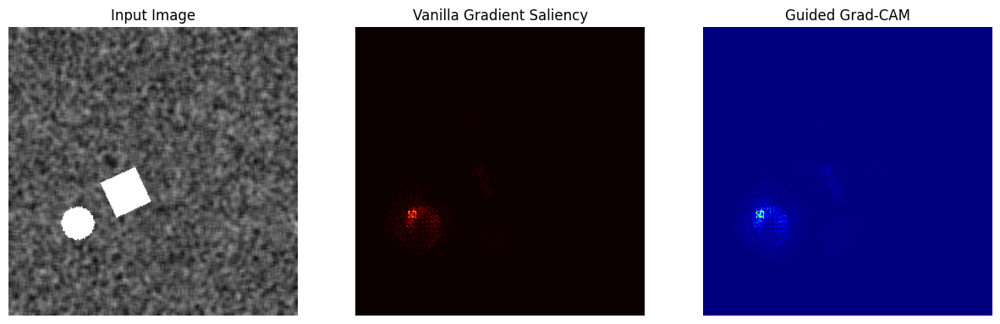

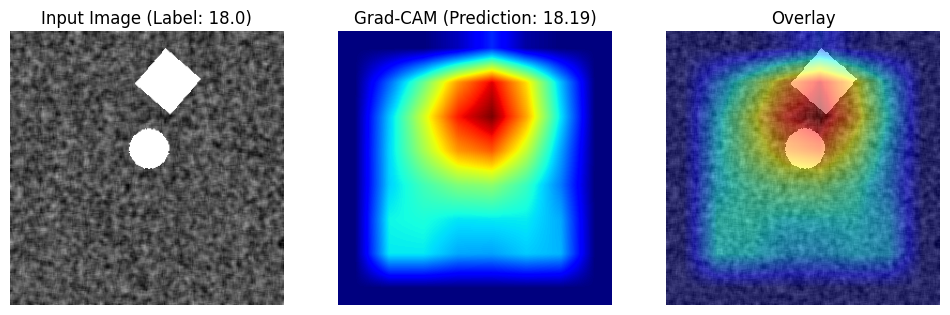

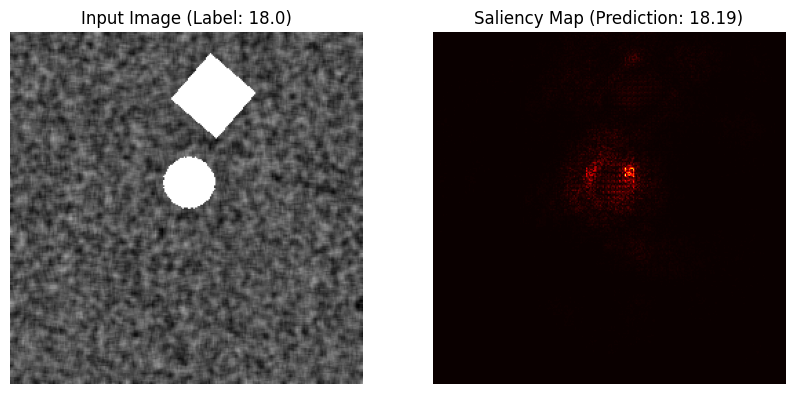

...

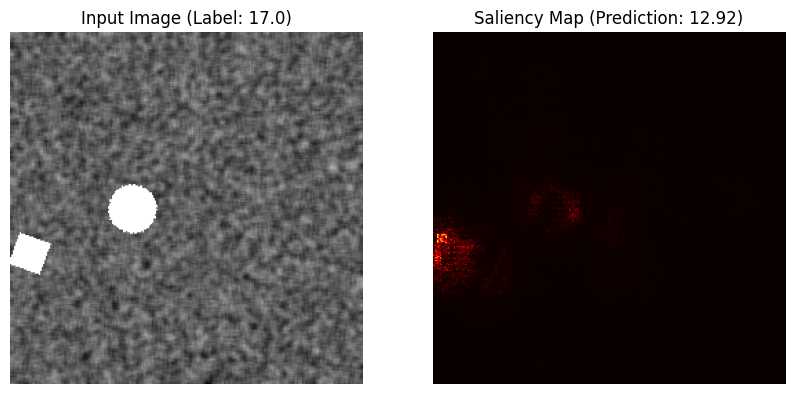

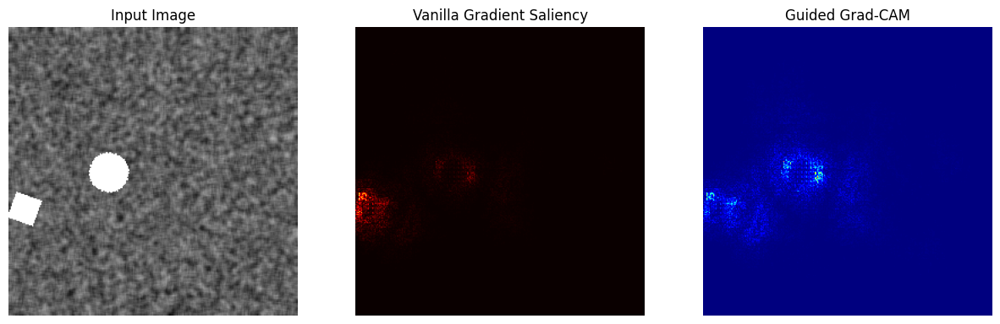

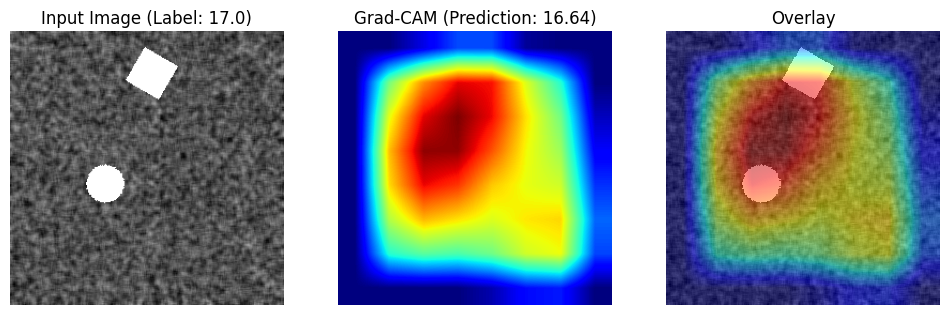

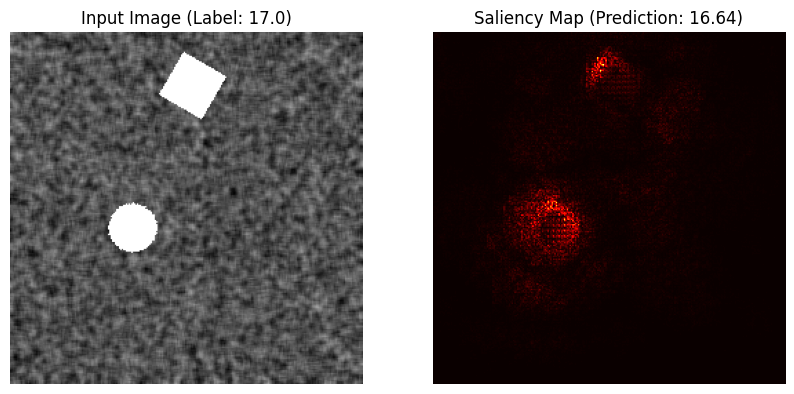

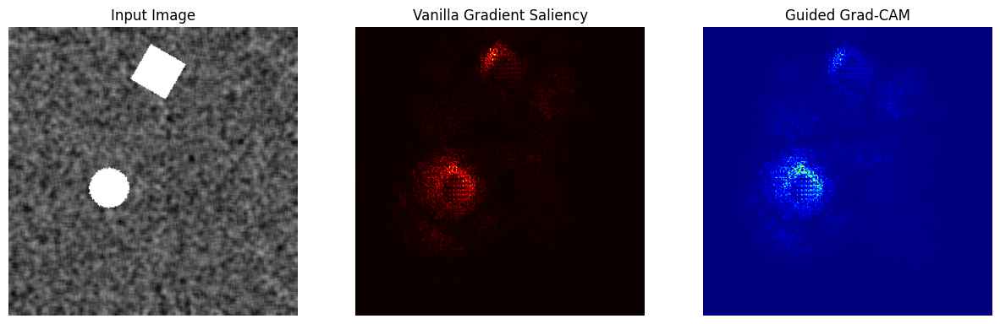

In [52]:
from src.XAI.GuideGradCam import GuidedGradCam
importlib.reload(sys.modules['src.XAI.GuideGradCam'])

guidedGrad = GuidedGradCam(grad_cam_mod, vanilla_saliency=xai_resnet)
guidedGrad.generate_multiple_guided_grad_cam(image_count=5, save_output=False, save_dir='guided_gradcam_output_multiple_10-30_resnet34_plus')